# **<font color="red">Perceptron</font>**
### **<font color="green">Perceptron Linear Model</font>**

Training Perceptron: 100%|███████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 2153.89it/s]


Total Training Time: 0.4672 seconds
✅ Perceptron Training Completed

Weights (coefficients): [[ 0.01993408 -0.04933977]]
Bias (intercept): [-0.01]

Training Accuracy: 100.00%
Test Accuracy: 97.78%

Training Misclassifications: 0
Test Misclassifications: 2
Confusion Matrix (Test Data):
[[42  0]
 [ 2 46]]


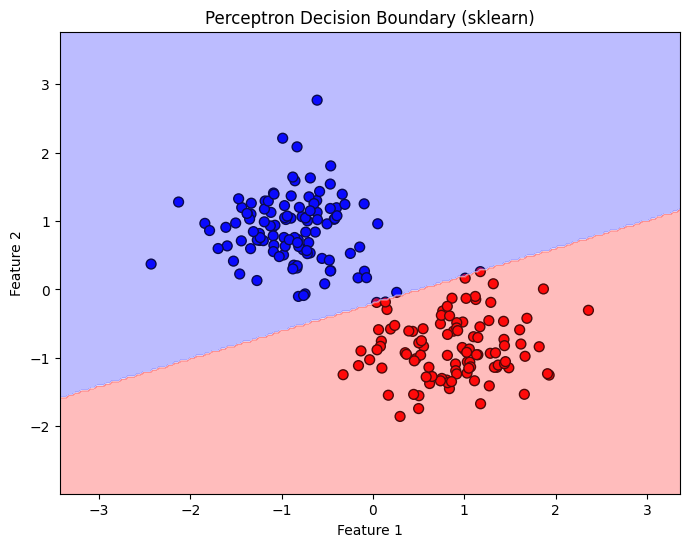

In [2]:
# sklearn_perceptron_2d_saveplot.py
# Train a Perceptron using scikit-learn on a 2D dataset with progress bar, training time, and saved plot.

import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.linear_model import Perceptron
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import time
from tqdm import tqdm

# ------------------- Step 1: Create a 2D dataset -------------------
X, y = make_blobs(n_samples=300, centers=2, n_features=2, cluster_std=2.0, random_state=42)

# Normalize features for stable training
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Split into training and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# ------------------- Step 2: Load Perceptron from sklearn -------------------
p = Perceptron(
    max_iter=1,       # one iteration per partial_fit call
    eta0=0.01,
    random_state=42,
    warm_start=True,  # keep training across calls to fit/partial_fit
    tol=None          # disable automatic stopping
)

# ------------------- Step 3: Train the model with progress bar -------------------
n_epochs = 1000
classes = np.unique(y_train)
start_time = time.time()

for epoch in tqdm(range(n_epochs), desc="Training Perceptron"):
    p.partial_fit(X_train, y_train, classes=classes)

end_time = time.time()
training_time = end_time - start_time

# Total training time
print(f"Total Training Time: {training_time:.4f} seconds")
print("✅ Perceptron Training Completed\n")

# ------------------- Step 4: Evaluate and Print Details -------------------
print("Weights (coefficients):", p.coef_)
print("Bias (intercept):", p.intercept_)

# Predict on train and test data
y_train_pred = p.predict(X_train)
y_test_pred = p.predict(X_test)

# Accuracy
train_acc = accuracy_score(y_train, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)

print(f"\nTraining Accuracy: {train_acc*100:.2f}%")
print(f"Test Accuracy: {test_acc*100:.2f}%")

# Error count
train_errors = np.sum(y_train != y_train_pred)
test_errors = np.sum(y_test != y_test_pred)
print(f"\nTraining Misclassifications: {train_errors}")
print(f"Test Misclassifications: {test_errors}")

# Confusion matrix
print("Confusion Matrix (Test Data):")
print(confusion_matrix(y_test, y_test_pred))

# ------------------- Step 5: Visualize and Save Decision Boundary -------------------
plt.figure(figsize=(8, 6))
plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', edgecolor='k', s=50)
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
Z = p.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
plt.contourf(xx, yy, Z, alpha=0.3, cmap='bwr')
plt.title("Perceptron Decision Boundary (sklearn)")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()


### **<font color="green">Perceptron Custom Class</font>**

Training Perceptron: 100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 55650.25it/s]


Training completed in 0.0220 seconds
Bias: -0.09999999999999992
Weights: [ 1.15839828 -0.44160573] 

Training Accuracy: 99.33%
Total Misclassifications: 2 



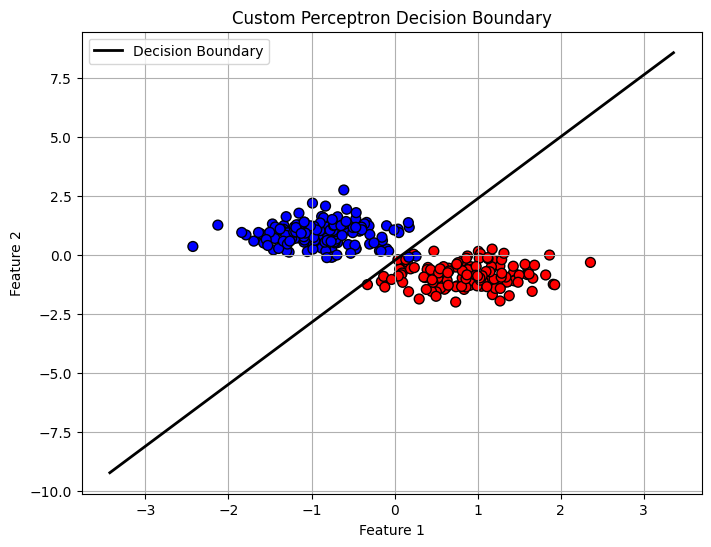

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler
import time
from tqdm import tqdm 

# ------------------- Step 0: Define your perceptron -------------------
def step(x):
    return 1 if x >= 0 else 0

def Perceptron(X, y, epoch):
    X = np.insert(X, 0, 1, axis=1)  # add bias term as column of 1s
    weights = np.ones(X.shape[1])
    lr = 0.1

    # Use tqdm for a progress bar
    for _ in tqdm(range(epoch), desc="Training Perceptron"):
        j = np.random.randint(0, X.shape[0])
        y_ = step(np.dot(X[j], weights))
        weights = weights + lr*(y[j] - y_)*X[j]

    return weights[0], weights[1:]  # bias, weights

# ------------------- Step 1: Create a 2D dataset -------------------
X, y = make_blobs(n_samples=300, centers=2, n_features=2, cluster_std=2.0, random_state=42)
scaler = StandardScaler()
X = scaler.fit_transform(X)

# ------------------- Step 2: Train perceptron -------------------
n_epochs = 1000
start_time = time.time()
bias, weights = Perceptron(X, y, n_epochs)
end_time = time.time()
training_time = end_time - start_time

print(f"\nTraining completed in {training_time:.4f} seconds")
print("Bias:", bias)
print("Weights:", weights, "\n")

# ------------------- Step 3: Calculate predictions and accuracy -------------------
X_aug = np.insert(X, 0, 1, axis=1)
weights_full = np.insert(weights, 0, bias)
y_pred = np.array([step(np.dot(xi, weights_full)) for xi in X_aug])

accuracy = np.mean(y_pred == y)
errors = np.sum(y_pred != y)

print(f"Training Accuracy: {accuracy*100:.2f}%")
print(f"Total Misclassifications: {errors} \n")

# ------------------- Step 4: Visualize decision boundary -------------------
plt.figure(figsize=(8,6))
plt.scatter(X[:,0], X[:,1], c=y, cmap='bwr', edgecolor='k', s=50)

x_min, x_max = X[:,0].min()-1, X[:,0].max()+1
y_min, y_max = X[:,1].min()-1, X[:,1].max()+1
xx = np.linspace(x_min, x_max, 200)
yy = (-bias - weights[0]*xx)/weights[1]  # x2 = (-b - w1*x1)/w2

plt.plot(xx, yy, color='black', linewidth=2, label="Decision Boundary")
plt.title("Custom Perceptron Decision Boundary")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.legend()
plt.grid(True)
plt.show()


In [24]:
# perceptron_animation_per_step.py
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler
from matplotlib.animation import FuncAnimation
from tqdm import tqdm
from IPython.display import HTML, display

# -------------------
# Config
# -------------------
np.random.seed(42)
n_epochs = 200           # number of perceptron updates (frames will be n_epochs + 1 including initial)
lr = 0.1
interval_ms = 100        # ms between frames (tweak for speed)
record_every = 1         # record every epoch -> show every step

# ------------------- Perceptron (stochastic) that records each step -------------------
def step_scalar(x):
    return 1 if x >= 0 else 0

def step_vector(z):
    return (z >= 0).astype(int)

def Perceptron_RecordPerStep(X, y, epochs, lr=0.1):
    """
    Stochastic perceptron that updates one random sample per epoch.
    Returns:
      - weight_history: list of augmented weight vectors; length = epochs+1 (includes initial)
      - sample_history: list of sample indices used to update for epoch i (length = epochs)
        sample_history[i] is the index used to compute the update that produced weight_history[i+1]
    """
    X = np.asarray(X)
    y = np.asarray(y).ravel()
    X_aug = np.insert(X, 0, 1.0, axis=1)  # bias column
    weights = np.zeros(X_aug.shape[1], dtype=float)  # initial weights (bias + w1 + w2)
    weight_history = [weights.copy()]  # store initial weights
    sample_history = []

    for epoch in tqdm(range(epochs), desc="Training (per-step record)"):
        j = np.random.randint(0, X_aug.shape[0])
        y_pred = step_scalar(np.dot(X_aug[j], weights))
        weights = weights + lr * (y[j] - y_pred) * X_aug[j]
        sample_history.append(int(j))
        weight_history.append(weights.copy())

    return weight_history, sample_history, X_aug

# ------------------- Data -------------------
X, y = make_blobs(n_samples=300, centers=2, n_features=2, cluster_std=2.0, random_state=42)
scaler = StandardScaler()
X = scaler.fit_transform(X)

# ------------------- Train & record -------------------
weight_history, sample_history, X_aug_full = Perceptron_RecordPerStep(X, y, n_epochs, lr=lr)

# Defensive check
if len(weight_history) == 0:
    raise RuntimeError("No weight history recorded — increase n_epochs or adjust record settings")

# ------------------- Plot setup -------------------
fig, ax = plt.subplots(figsize=(8, 6))
pts = ax.scatter(X[:, 0], X[:, 1], c=y, cmap='bwr', edgecolor='k', s=50, zorder=1)

x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
xx = np.linspace(x_min, x_max, 400)
y_min_plot = X[:, 1].min() - 1
y_max_plot = X[:, 1].max() + 1

ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min_plot, y_max_plot)
ax.set_xlabel("Feature 1 (scaled)")
ax.set_ylabel("Feature 2 (scaled)")

# Line for decision boundary and a marker for the sample used this epoch
boundary_line, = ax.plot([], [], linewidth=2, zorder=2)
sample_marker, = ax.plot([], [], marker='o', markersize=16, markerfacecolor='none',
                         markeredgecolor='k', markeredgewidth=2, linestyle='None', zorder=3)
title_text = ax.set_title("Perceptron — initial")

# ------------------- Helpers -------------------
def compute_boundary_line(w):
    """
    w is augmented [bias, w1, w2]
    Return xs, ys arrays for plotting. For near-vertical boundaries, return vertical line.
    """
    bias = float(w[0])
    w1 = float(w[1])
    w2 = float(w[2])

    if abs(w2) < 1e-9:
        # nearly vertical -> x = -bias / w1
        if abs(w1) < 1e-12:
            return np.array([]), np.array([])
        x_val = -bias / w1
        xs = np.array([x_val, x_val])
        ys = np.array([y_min_plot, y_max_plot])
        return xs, ys
    ys = (-bias - w1 * xx) / w2
    return xx, ys

def compute_accuracy(w):
    scores = X_aug_full.dot(w)
    preds = step_vector(scores)
    return float((preds == y).mean() * 100.0)

# ------------------- Animation update -------------------
def update(frame):
    """
    Frame corresponds to index into weight_history.
    weight_history[0] = initial (frame 0)
    For frame >=1, sample_history[frame-1] is the sample used to produce weight_history[frame]
    """
    w = weight_history[frame]
    xs, ys = compute_boundary_line(w)

    if xs.size == 0:
        boundary_line.set_data([], [])
    else:
        boundary_line.set_data(xs, ys)

    # highlight the sample used to create this weight (for frame>=1)
    if frame == 0:
        sample_marker.set_data([], [])
    else:
        sample_idx = sample_history[frame - 1]
        sx, sy = X[sample_idx, 0], X[sample_idx, 1]
        sample_marker.set_data([sx], [sy])

    approx_epoch = frame  # since we recorded every epoch, frame == epoch index (initial=0)
    acc = compute_accuracy(w)
    title_text.set_text(f"Epoch {approx_epoch:3d}    Accuracy: {acc:5.1f}%")
    return boundary_line, sample_marker, title_text

# Use blit=False for maximum compatibility with to_jshtml
ani = FuncAnimation(fig, update, frames=len(weight_history), interval=interval_ms, blit=False, repeat=False)

# ------------------- Display (no saving) -------------------
display_js = False
try:
    html = ani.to_jshtml()
    display(HTML(html))
    display_js = True
except Exception as e:
    print("JS animation embedding failed in this environment (some JupyterLab configs).")
    print("No files will be saved. Final static plot will be shown below.")

# ------------------- Final static plot -------------------
final_w = weight_history[-1]
print("\nTraining completed.")
print("Final bias:", float(final_w[0]))
print("Final weights:", np.array(final_w[1:], dtype=float))

plt.figure(figsize=(8, 6))
plt.scatter(X[:, 0], X[:, 1], c=y, cmap='bwr', edgecolor='k', s=50)
xs_final, ys_final = compute_boundary_line(final_w)
if xs_final.size > 0:
    plt.plot(xs_final, ys_final, linewidth=2, label="Final decision boundary")
plt.title("Final Decision Boundary after Training")
plt.xlabel("Feature 1 (scaled)")
plt.ylabel("Feature 2 (scaled)")
plt.grid(True)
plt.legend()
plt.show()



Training (per-step record): 100%|█████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25163.06it/s]


<IPython.core.display.Javascript object>

Animation size has reached 21022435 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.



Training completed.
Final bias: 0.0
Final weights: [ 0.08605521 -0.07516313]


<IPython.core.display.Javascript object>